# DCGAN - Deep Convolutional Generative Adversarial Networks

[To see more details on this tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html).

[Another tutorial we'll follow](https://machinelearningmastery.com/building-a-convolutional-neural-network-in-pytorch/).

First goal is to build up a generator *G* that gives in output some images starting from noise.
Second goal is to build a discriminator *D* that tells us which images are coming from the generator and which are real.

**NOTE**: *G* never sees real images but only learn how to beat *D*. On the other hand, *D* is trained on both datasets (real and fake).

A GAN is very hard to train, requires GPU and a lot of time... so we'll try our best.
We're going to work with face images, which need to be resized to 64x64.
All images have three channels: red, green and blue.
The package *vision* in PyTorch is going to help us with these operations.

We'll use a convolutional network.
It may be that the number of feature will be very big despite the images becoming very small.

$x$ is going to be a data sample, a tensor of 3x64x64.
*D* is our discriminator.
The latent space is a vector of dimension 100 of pure noise.
*G* is our generator.

*D* wants to maximize its probability to guess right, while *G* wants to minimize it.
For a mathematical POV of GANs, see [this reference](https://proceedings.neurips.cc/paper_files/paper/2014/file/5ca3e9b122f61f8f06494c97b1afccf3-Paper.pdf).
We're just assuming that a solution to our problem exists, which is true but in which space?

We'll use the structure described in [this paper](https://arxiv.org/pdf/1511.06434.pdf).
This is not a GAN but a DCGAN, i.e. a Deep Convolutional GAN.
The idea is to convoy similar images in order to extract features.
What's similarity is another problem.

![pipeline](https://pytorch.org/tutorials/_images/dcgan_generator.png)

Going through, we increase the dimension while decreasing the number of channels.

The pipeline, we've a transposed convolution between each step:
1. $\vec{z}$ noise vector
2. black box which decreases the size of our images while increasing the size pf the features - out 3x64x64 feature
3. layer with 256 features of the images

*D* is made of convolution layers.
We don't want to fluctuate a lot (in the neurons) so we chose a Leaky ReLU, which is not as flat as the hyperbolic tangent.

We'll use torch vision, a library built to use torch with images.

In [15]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed);

Random Seed:  999


We need now to set some parameters.
[Download the dataset](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) and put it in "data/celeba".

In [16]:
# Root directory for dataset
dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 30

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

Basically torch vision is doing the hard work for us.

We have, in fact, to *standardize* our sample images in order to feed them into the convolutional operator.
The *DataLoader* is an instance of our data, while being also an iterable object.
We'll call it each time we want a batch or similar.
It automatically shuffles and does batch things (*batch noise*).

With the *iter()* function we can make an object iterable.
Then with *next()* we can advance of one element.
It's more or less what we usually do with C++ iterators.
How do we tell where's the end of the iterated object?
This is simply done by using the *enumerate()* function and letting python solve this problem.

*real_batch* is just a list of two elements: one is a tensor containing the images, the second is a tensor containing the labels.
Moreover, we transpose the tensors as (3, 64, 64) --→ (64, 64, 3).
We don0t have to worry about it because the data loader is going to do all the work (but we have to know what are we doing!).

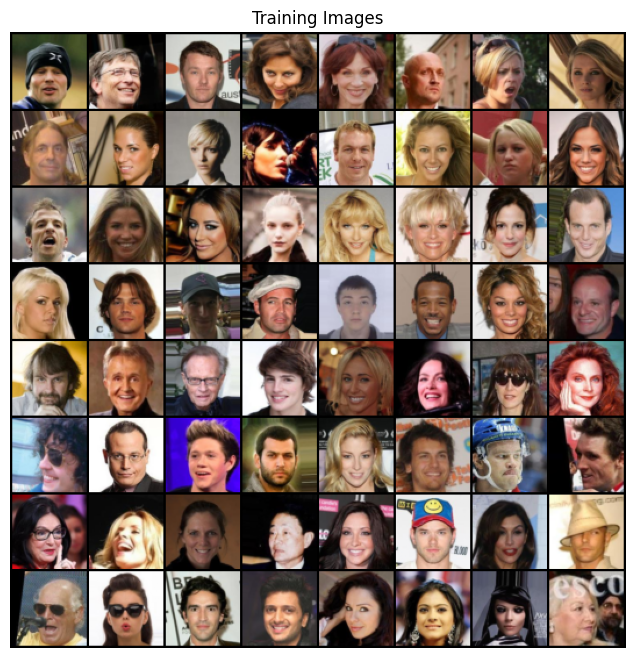

In [17]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8));
plt.axis("off");
plt.title("Training Images");
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)));

*G* will take the input $\vec{z}$ of dimension 100 and **up sample** (increase the number of channels) with a transposed convolutional network, giving in output a 3x64x64 dimensional tensor.
A discrete convolution operator has an input, which is an image with only one channel (monochromatic).
It also requires a *kernel*, which is usually a 3x3 matrix (or at least smaller than the image).
The convolution is done within the image and the kernel, like we do in image processing (e.g. filtering).

[To learn more about convolution](https://arxiv.org/pdf/1603.07285.pdf).

[To visualize what a convolution does](https://hannibunny.github.io/mlbook/neuralnetworks/convolutionDemos.html).

We use different kernels to gain different info, e.g. edges.
One famous operation is the max pooling, used as much as the average pooling.

Now we want to define two networks, one for the generator and one for the discriminator.
We want the weights to be small at the beginning in order to use a normal distribution.

In [18]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

[To see the real convolution function](https://pytorch.org/docs/stable/generated/torch.nn.ConvTranspose2d.html).

There is a relation between the number of zeros (padding $p$), the dimension of the kernel $k$, the length of the image $i$ and the stripe $s$ (how much we jump with our filter).
The dimension of the output image is completely determined by the previous parameters:
$$
    o = \lvert \frac{i + 2p - k}{s} \rvert + 1
$$

**NOTE**: the generator is doing the opposite of the discriminator!
The discriminator is doing the convolution while the generator is using the transposed convolution (deconvolution).
Actually the convolution operator is not invertible, so it's not the inverse in terms of values, but it is in terms of dimensions.

So while the convolution takes the image and gives out something small, the deconvolution takes in something small and enlarges it.

In [19]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

*D* is another thing.
It goes not through transpose convolution but *genuine*.
It will **down sampling**, i.e. aggregate spatial information while increasing the number of channels.
The output will be one number, i.e. 0 if the image is fake or 1 if it's not.
All the convolution operators works with parameters changing during training.

In [20]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [21]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            # takes an image of 64x64, pads by 1, strides by 2 (moving two steps at a time), and applies a 4x4 kernel
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Send all the model to GPU and hope.

In [22]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


Now we want to train... what is the loss function?

In this case it's simple because it's a binary one (*BC-ELoss()* of PyTorch).
Then, we construct a batch of random noise (normally distributed).
For each batch we generate a tensor of dimension (1, 1, 100), where 100 is the dimension of channels.
Why 100? Eh EH!
We don't know.
Just don't ask and all will be fine.

Then, we label the images (very easy to do), and define the optimizers.

In [23]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

We're going to train now.
There are some tricks we're going to use.

Training GAN can be very difficult... they usually fall into loops.
*D(x)* needs to be as close to zero as possible (so the log as close to zero as possible, which is the opposite, grr).
Basically, once fixed the generator we'll maximize the discriminator in two steps:
- construct real images, calculate the loss and the gradient to maximize **without changing the parameters**, only computing.
- **without touching *G* and *D*** we create fake images and maximize *D* again, then we sum the two gradients.

In [24]:
from tqdm.autonotebook import trange
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in trange(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        # label is just a vector of ones
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        # detach() is used to avoid backprop through a variable (less memory usage)
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # it wants to foul D...
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


  0%|          | 0/30 [00:00<?, ?it/s]

[0/30][0/1583]	Loss_D: 1.9100	Loss_G: 6.3743	D(x): 0.7247	D(G(z)): 0.7207 / 0.0032
[0/30][50/1583]	Loss_D: 0.1117	Loss_G: 14.8767	D(x): 0.9388	D(G(z)): 0.0000 / 0.0000
[0/30][100/1583]	Loss_D: 0.5441	Loss_G: 15.0935	D(x): 0.9766	D(G(z)): 0.3376 / 0.0000
[0/30][150/1583]	Loss_D: 0.2738	Loss_G: 4.8203	D(x): 0.9037	D(G(z)): 0.1035 / 0.0224
[0/30][200/1583]	Loss_D: 0.7405	Loss_G: 3.1751	D(x): 0.6080	D(G(z)): 0.0720 / 0.0621
[0/30][250/1583]	Loss_D: 0.4057	Loss_G: 3.7363	D(x): 0.7760	D(G(z)): 0.0788 / 0.0336
[0/30][300/1583]	Loss_D: 0.6122	Loss_G: 4.5775	D(x): 0.6861	D(G(z)): 0.0877 / 0.0431
[0/30][350/1583]	Loss_D: 0.7129	Loss_G: 3.2661	D(x): 0.7908	D(G(z)): 0.2932 / 0.0617
[0/30][400/1583]	Loss_D: 0.5784	Loss_G: 5.2064	D(x): 0.8225	D(G(z)): 0.2283 / 0.0121
[0/30][450/1583]	Loss_D: 0.6850	Loss_G: 4.4506	D(x): 0.7969	D(G(z)): 0.2781 / 0.0215
[0/30][500/1583]	Loss_D: 0.7033	Loss_G: 3.2423	D(x): 0.6488	D(G(z)): 0.0601 / 0.0707
[0/30][550/1583]	Loss_D: 0.4272	Loss_G: 4.8669	D(x): 0.8952	D(G(z)

In [25]:
# save the model
torch.save(netG.state_dict(), 'dcgan_generator.pt')

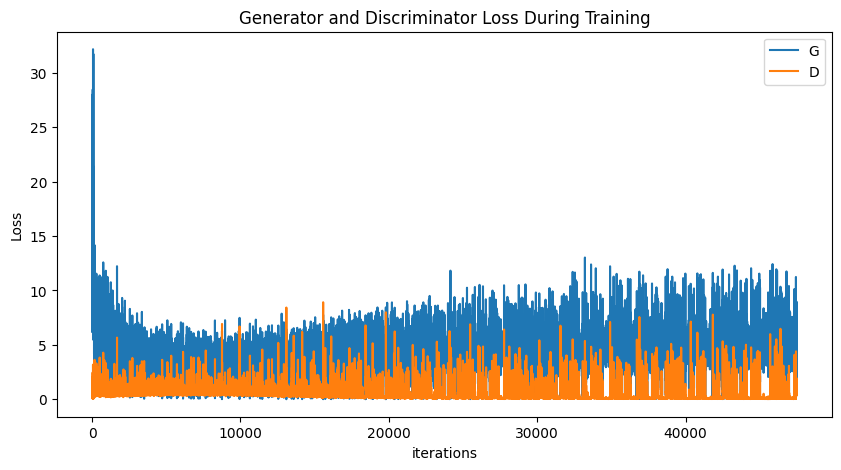

In [26]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21077774 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


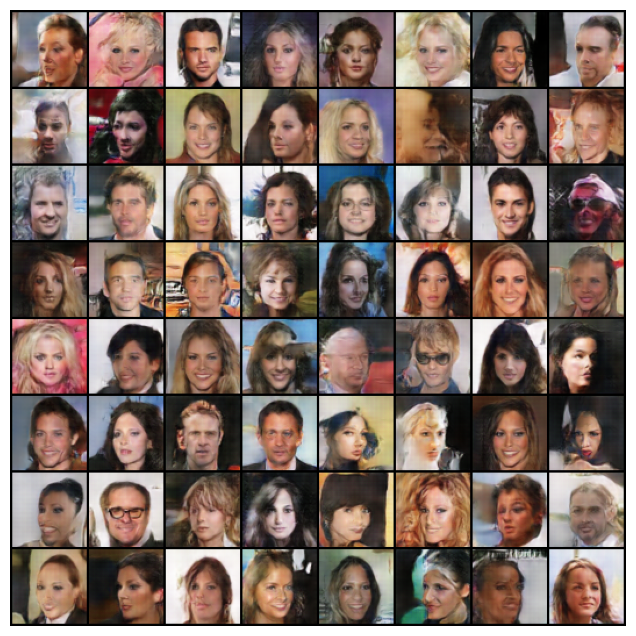

In [27]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

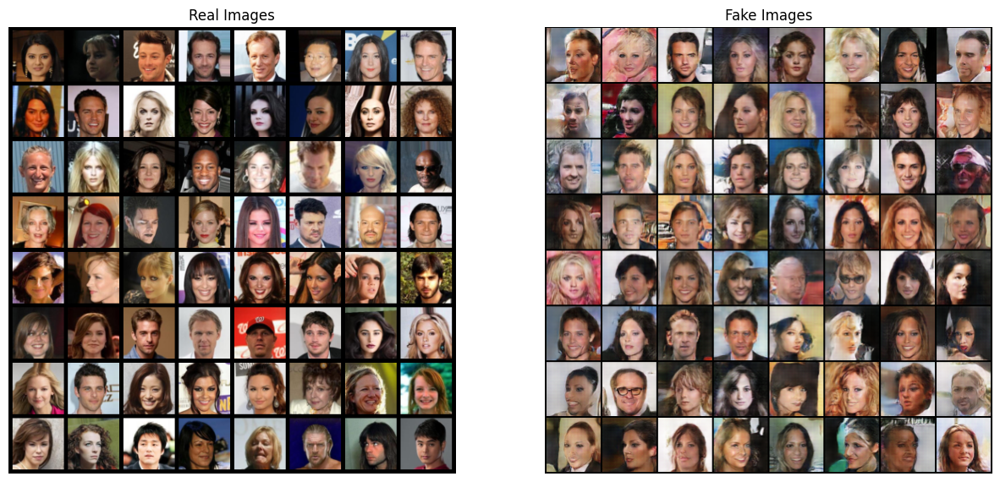

In [28]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()